<a href="https://colab.research.google.com/github/Ugo5738/Convolutional-Neural-Networks-Projects/blob/main/Mask_Type_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Install Dependencies

In [43]:
!pip install xmltodict

In [44]:
# load and prepare face mask dataset and save to file
from os import listdir
from numpy import zeros
from numpy import asarray
from numpy import savez_compressed
from pandas import read_csv
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array

In [45]:
import xmltodict
import pandas as pd
import numpy as np
import os
import zipfile
from tqdm.auto import tqdm
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
from pathlib import Path

plt.style.use(['seaborn-white'])

In [46]:
# test f-beta score
from numpy import load
from numpy import ones
from numpy import asarray
from sklearn.model_selection import train_test_split
from sklearn.metrics import fbeta_score

In [47]:
import tensorflow as tf

# Download Dataset from Kaggle

In [ ]:
!pip install --quiet kaggle

# upload the kaggle.json file from your local system
from google.colab import files 
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"ugochukwunwachukwu","key":"bf40d33f01a1437a69ae5fb2505e2f7e"}'}

In [ ]:
# make the /.kaggle directory
!mkdir -p ~/.kaggle

# copy the kaggle.json file into the /.kaggle directory
!cp kaggle.json ~/.kaggle
# check the files in the /.kaggle directory

!ls /root/.kaggle/
# check the file permission 

!ls -l ~/.kaggle/kaggle.json
# change file permission
# chmod 600 - owner can write and read
# chmod 700 - owner can write, read and execute

!chmod 600 ~/.kaggle/kaggle.json

kaggle.json
-rw-r--r-- 1 root root 74 Mar 29 22:58 /root/.kaggle/kaggle.json


In [ ]:
!kaggle datasets list -s 'Face Mask Detection Dataset'

ref                                                              title                                                size  lastUpdated          downloadCount  
---------------------------------------------------------------  --------------------------------------------------  -----  -------------------  -------------  
andrewmvd/face-mask-detection                                    Face Mask Detection                                 398MB  2020-05-22 07:18:42          14386  
wobotintelligence/face-mask-detection-dataset                    Face Mask Detection Dataset                           2GB  2020-06-14 19:06:22           4913  
omkargurav/face-mask-dataset                                     Face Mask Detection Dataset                         163MB  2020-07-31 18:34:42           2043  
prithwirajmitra/covid-face-mask-detection-dataset                COVID Face Mask Detection Dataset                   207MB  2020-07-15 16:57:21           2469  
prasoonkottarathil/face-mask-lite-

In [ ]:
!kaggle datasets download -d wobotintelligence/face-mask-detection-dataset

 28% 727M/2.50G [00:19<01:00, 31.7MB/s]

# Unzip Dataset into working directories

In [ ]:
base_dir = '/content/face-mask-detection-dataset.zip'
zip_ref = zipfile.ZipFile(base_dir, 'r')
zip_ref.extractall('/tmp')
zip_ref.close()

# Data Wrangling

In [ ]:
base_dir = '/tmp/'
train_dir = '/tmp/Medical mask/Medical mask/Medical Mask/'
os.listdir(train_dir)

['annotations', 'images']

In [ ]:
train_image_dir = os.path.join(train_dir, "images")
train_annotation_dir = os.path.join(train_dir, "annotations")

In [ ]:
train_csv_data = pd.read_csv(os.path.join(base_dir, "train.csv")) # convert the csv file into a dataframe

In [ ]:
train_csv_data

,name,x1,x2,y1,y2,classname
0,2756.png,69,126,294,392,face_with_mask
1,2756.png,505,10,723,283,face_with_mask
2,2756.png,75,252,264,390,mask_colorful
3,2756.png,521,136,711,277,mask_colorful
4,6098.jpg,360,85,728,653,face_no_mask
...,...,...,...,...,...,...
15407,1894.jpg,437,121,907,644,face_with_mask
15408,1894.jpg,557,363,876,636,mask_surgical
15409,1894.jpg,411,3,940,325,hat
15410,3216.png,126,69,409,463,face_with_mask


In [ ]:
train_csv_data.name.unique().shape # returns the shape of the unique image name in the name column

(4326,)

In [ ]:
train_csv_data.classname.value_counts() # returns the count of unique image annotation in the classname category

face_with_mask              4180
mask_surgical               2430
mask_colorful               1876
face_no_mask                1569
face_other_covering         1372
eyeglasses                   914
hat                          823
sunglasses                   358
hair_net                     287
scarf_bandana                260
goggles                      192
helmet                       187
hijab_niqab                  173
face_shield                  160
hood                         159
face_with_mask_incorrect     150
balaclava_ski_mask           134
turban                        94
gas_mask                      55
other                         39
Name: classname, dtype: int64

In [19]:
df = train_csv_data[['name', 'classname']]
df

,name,classname
0,2756.png,face_with_mask
1,2756.png,face_with_mask
2,2756.png,mask_colorful
3,2756.png,mask_colorful
4,6098.jpg,face_no_mask
...,...,...
15407,1894.jpg,face_with_mask
15408,1894.jpg,mask_surgical
15409,1894.jpg,hat
15410,3216.png,face_with_mask


In [29]:
grouped_df = df.groupby('name')

# To see the groups in grouped_df

training_data = {}
for cover_type, cover_df in grouped_df:
    training_data[cover_type] = cover_df.classname.values.tolist()

# training_data

df = pd.DataFrame(list(training_data.items()),columns = ['image', 'cover_type']) 
df

,image,cover_type
0,1801.jpg,[face_no_mask]
1,1802.jpg,"[face_with_mask, mask_surgical]"
2,1803.jpg,"[face_with_mask, mask_surgical]"
3,1804.jpg,"[face_with_mask, mask_surgical]"
4,1805.jpg,"[face_with_mask, mask_surgical, hat]"
...,...,...
4321,6431.png,"[mask_colorful, face_with_mask_incorrect]"
4322,6432.jpg,"[sunglasses, mask_surgical, mask_surgical, fac..."
4323,6433.png,"[face_with_mask, face_with_mask, face_with_mas..."
4324,6434.jpg,"[mask_colorful, face_with_mask]"


In [31]:
df.cover_type[810]

['face_with_mask', 'mask_surgical', 'eyeglasses', 'hood']

# Visualize Images

In [ ]:
def read_image(f_name, IMAGE_PATH, max_size=224):
    img = cv2.imread(str(Path(IMAGE_PATH).joinpath(f_name))) # join the filename to the image directory, convert it to a string and load it with cv2
    
#    ratio = img.shape[0] / img.shape[1] # ratio to resize with (Height/Width)
#    dim = (max_size, int(max_size / ratio)) if ratio > 1 else (int(max_size / ratio), max_size)
    dim = (150, 150)
    img = cv2.resize(img, dim)
    print(img)
    return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

(150, 150, 3)


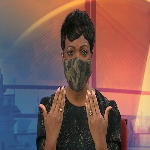

In [ ]:
# To show an example of what the resized images look like
img = cv2.imread(str(Path(train_image_dir).joinpath(os.listdir(train_image_dir)[1]))) # join the filename to the image directory, convert it to a string and load it with cv2

dim = (150, 150)
img = cv2.resize(img, dim)
print(img.shape)
cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
from google.colab.patches import cv2_imshow
cv2_imshow(img)   

In [ ]:
fig = make_subplots(20, 3, subplot_titles=list(sample_per_class.classname))

img_plots = list(map(lambda x: go.Image(z=read_image(x, train_image_dir)), sample_per_class.name))

fig.add_traces(
    data = img_plots,
    rows = list(map(lambda x: x//3+1, range(0, 20*3))),
    cols = list(range(1, 4)) * 20
)

fig.update_layout(height=6000, showlegend=False)
fig.update_xaxes(showticklabels=False).update_yaxes(showticklabels=False)

fig.show()

[[[  3  27  38]
  [  5  16  25]
  [ 46  51  52]
  ...
  [120 132 122]
  [183 185 176]
  [143 144 135]]

 [[103 138 155]
  [ 65 123 136]
  [ 20  40  41]
  ...
  [143 151 140]
  [139 135 125]
  [138 139 129]]

 [[ 86 138 171]
  [  4  33  38]
  [ 25  47  28]
  ...
  [144 144 133]
  [185 182 168]
  [ 94  97  86]]

 ...

 [[ 25  39  46]
  [ 21  28  28]
  [ 48  47  62]
  ...
  [ 42  45  53]
  [136 131 119]
  [ 66  60  78]]

 [[ 82 103 110]
  [ 96 106 106]
  [111 112 127]
  ...
  [ 23  29  47]
  [ 82  88  91]
  [157 152 153]]

 [[ 31  58  65]
  [ 42  57  58]
  [ 33  39  51]
  ...
  [ 30  38  63]
  [ 39  53  69]
  [166 160 149]]]
[[[206 209 216]
  [206 209 216]
  [206 209 216]
  ...
  [212 215 223]
  [211 214 222]
  [212 215 223]]

 [[207 210 218]
  [207 210 218]
  [207 210 218]
  ...
  [211 214 222]
  [210 213 221]
  [212 215 223]]

 [[206 209 217]
  [206 209 217]
  [206 209 217]
  ...
  [209 212 220]
  [217 220 228]
  [228 231 239]]

 ...

 [[239 239 233]
  [244 243 239]
  [242 241 237]
  ..

# Create Training and Testing Datasets

In [34]:
# create a mapping of tags to integers given the loaded mapping file
def create_tag_mapping(df):
    # create a set of labels
    labels = set()
    for i in range(len(df)):
        # convert spaced separated tags into an array of tags
        # tags = mapping_csv['tags'][i].split(' ')
        tags = df['cover_type'][i]
        # add tags to the set of known labels
        labels.update(tags)
    # convert set of labels to a list to list
    labels = list(labels)
    # order set alphabetically
    labels.sort()
    # dict that maps labels to integers, and the reverse
    labels_map = {labels[i]:i for i in range(len(labels))}
    inv_labels_map = {i:labels[i] for i in range(len(labels))}
    return labels_map, inv_labels_map

In [35]:
# create a mapping of tags to integers
mapping, inv_mapping = create_tag_mapping(df)
print(len(mapping))
print(mapping)

20
{'balaclava_ski_mask': 0, 'eyeglasses': 1, 'face_no_mask': 2, 'face_other_covering': 3, 'face_shield': 4, 'face_with_mask': 5, 'face_with_mask_incorrect': 6, 'gas_mask': 7, 'goggles': 8, 'hair_net': 9, 'hat': 10, 'helmet': 11, 'hijab_niqab': 12, 'hood': 13, 'mask_colorful': 14, 'mask_surgical': 15, 'other': 16, 'scarf_bandana': 17, 'sunglasses': 18, 'turban': 19}


In [36]:
# create a mapping of filename to tags
def image_labels(df):
    image_labels = dict()
    for i in range(len(df)):
        name, tags = df['image'][i], df['cover_type'][i]
        image_labels[name] = tags#.split(' ')
    return image_labels

In [37]:
image_labelling = image_labels(df)
print(image_labelling)

{'1801.jpg': ['face_no_mask'], '1802.jpg': ['face_with_mask', 'mask_surgical'], '1803.jpg': ['face_with_mask', 'mask_surgical'], '1804.jpg': ['face_with_mask', 'mask_surgical'], '1805.jpg': ['face_with_mask', 'mask_surgical', 'hat'], '1806.jpg': ['face_with_mask', 'mask_surgical', 'eyeglasses'], '1807.jpg': ['face_other_covering', 'hat'], '1808.jpg': ['face_no_mask', 'face_no_mask'], '1809.jpg': ['face_no_mask'], '1810.jpg': ['face_with_mask_incorrect', 'face_with_mask', 'face_with_mask', 'face_with_mask', 'face_with_mask_incorrect', 'eyeglasses', 'eyeglasses', 'mask_surgical', 'mask_surgical', 'mask_surgical', 'mask_surgical', 'mask_surgical'], '1811.jpg': ['face_no_mask'], '1812.jpg': ['face_with_mask', 'face_with_mask', 'mask_surgical', 'mask_surgical', 'eyeglasses', 'face_with_mask', 'mask_colorful', 'face_no_mask', 'face_no_mask', 'face_no_mask'], '1813.jpg': ['face_no_mask'], '1814.jpg': ['face_no_mask'], '1815.jpg': ['face_no_mask'], '1817.jpg': ['face_other_covering', 'helmet',

In [38]:
# create a one hot encoding for one list of tags
def one_hot_encode(photo_tag, image_labels):
    # create empty vector
    encoding = zeros(len(image_labels), dtype='uint8')
    # mark 1 for each tag in the vector
    for tag in photo_tag:
        encoding[image_labels.get(tag)] = 1
    return encoding

In [39]:
# load all images into memory
def load_dataset(new_image_list, file_mapping, tag_mapping):
    photos, targets = list(), list()
    # enumerate files in the directory
    for filename in new_image_list:
        # load image
        image_path = os.path.join(image_dir, filename)
        photo = load_img(image_path, target_size=(150,150))
        # convert to numpy array
        photo = img_to_array(photo, dtype='uint8')
        # get tags of image
        photo_tag = file_mapping.get(filename)
        # one hot encode tags
        target = one_hot_encode(photo_tag, tag_mapping)
        # store
        photos.append(photo)
        targets.append(target)
    training_images = asarray(photos, dtype='uint8')
    training_labels = asarray(targets, dtype='uint8')
    return training_images, training_labels

In [41]:
image_dir = '/tmp/Medical mask/Medical mask/Medical Mask/images'
image_dir_list = os.listdir(image_dir)
# Remove images that have no labels and would return NoneTypes
new_image_list = [image for image in image_dir_list if image_labelling.get(image) is not None]
print(f"{len(image_dir_list) - len(new_image_list)} out of {len(image_dir_list)} returns a null value. So we are only working with {len(new_image_list)} images")

1698 out of 6024 returns a null value. So we are only working with 4326 images


In [48]:
# load the jpeg images
training_images, training_labels = load_dataset(new_image_list, image_labelling, mapping)
print(training_images.shape, training_labels.shape)
# save both arrays to one file in compressed format
savez_compressed('face_mask_type_data.npz', training_images, training_labels)

(4326, 150, 150, 3) (4326, 20)


In [53]:
# load train and test dataset
def load_dataset():
    # load dataset
    fask_mask_type_data = load('/content/face_mask_type_data.npz')
    images, labels = fask_mask_type_data['arr_0'], fask_mask_type_data['arr_1']
    # separate into train and test datasets
    training_images, testing_images, training_labels, testing_labels = train_test_split(images, labels, test_size=0.3, random_state=1)
    print(training_images.shape, testing_images.shape, training_labels.shape, testing_labels.shape)
    return training_images, testing_images, training_labels, testing_labels

# Build Custom Model

In [59]:
model = tf.keras.Sequential([
                             tf.keras.layers.Conv2D(16, (3,3), activation='relu', input_shape=(150, 150, 3)),
                             tf.keras.layers.MaxPooling2D(2,2),
                             tf.keras.layers.Conv2D(32, (3,3), activation='relu'),
                             tf.keras.layers.MaxPooling2D(2,2),
                             tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
                             tf.keras.layers.MaxPooling2D(2,2),
                             tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
                             tf.keras.layers.MaxPooling2D(2,2),                                               
                             tf.keras.layers.Flatten(),
                             tf.keras.layers.Dense(512, activation='relu'),
                             tf.keras.layers.Dense(20, activation='sigmoid')
])

model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_8 (Conv2D)            (None, 148, 148, 16)      448       
_________________________________________________________________
max_pooling2d_8 (MaxPooling2 (None, 74, 74, 16)        0         
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 72, 72, 32)        4640      
_________________________________________________________________
max_pooling2d_9 (MaxPooling2 (None, 36, 36, 32)        0         
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 34, 34, 64)        18496     
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 17, 17, 64)        0         
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 15, 15, 128)      

In [60]:
from tensorflow.keras.optimizers import SGD
model.compile(optimizer=SGD(lr=0.01, momentum=0.9),
              loss='binary_crossentropy',
              metrics=['accuracy'])

In [61]:
training_images, testing_images, training_labels, testing_labels = load_dataset()

(3028, 150, 150, 3) (1298, 150, 150, 3) (3028, 20) (1298, 20)


In [62]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator(rescale=1/255,
                                   rotation_range=40,
                                   width_shift_range=0.2,
                                   height_shift_range=0.2,
                                   shear_range=0.2,
                                   zoom_range=0.2,
                                   horizontal_flip=True,
                                   fill_mode='nearest'
                                   )
train_generator = train_datagen.flow(training_images,
                                     training_labels,
                                     batch_size=32)


validation_datagen = ImageDataGenerator(rescale=1/255)
validation_generator = validation_datagen.flow(testing_images,
                                               testing_labels,
                                               batch_size=32)

In [63]:
history = model.fit(train_generator,
                    steps_per_epoch=len(training_images)/32,
                    epochs=10,
                    verbose=1,
                    validation_data=validation_generator,
                    validation_steps=len(testing_images)/32
          )

Epoch 1/10
94/94 [==============================] - 76s 795ms/step - loss: 0.4441 - accuracy: 0.2795 - val_loss: 0.2904 - val_accuracy: 0.4260
Epoch 2/10
94/94 [==============================] - 76s 801ms/step - loss: 0.2903 - accuracy: 0.4450 - val_loss: 0.2909 - val_accuracy: 0.4260
Epoch 3/10
94/94 [==============================] - 76s 800ms/step - loss: 0.2883 - accuracy: 0.4376 - val_loss: 0.2887 - val_accuracy: 0.4260
Epoch 4/10
94/94 [==============================] - 76s 802ms/step - loss: 0.2908 - accuracy: 0.4384 - val_loss: 0.2891 - val_accuracy: 0.4260
Epoch 5/10
94/94 [==============================] - 76s 801ms/step - loss: 0.2938 - accuracy: 0.4158 - val_loss: 0.2884 - val_accuracy: 0.4260
Epoch 6/10
94/94 [==============================] - 79s 832ms/step - loss: 0.2870 - accuracy: 0.4329 - val_loss: 0.2884 - val_accuracy: 0.4260
Epoch 7/10
94/94 [==============================] - 77s 811ms/step - loss: 0.2899 - accuracy: 0.4348 - val_loss: 0.2871 - val_accuracy: 0.4260

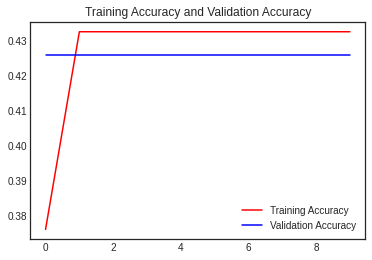

<Figure size 432x288 with 0 Axes>

In [64]:
acc = history.history['accuracy']
val = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'r', label='Training Accuracy')
plt.plot(epochs, val, 'b', label='Validation Accuracy')
plt.title('Training Accuracy and Validation Accuracy')
plt.legend(loc=0)
plt.figure()

plt.show()

In [67]:
import numpy as np
from google.colab import files
from tensorflow.keras.preprocessing import image

uploaded = files.upload()

for fn in uploaded.keys():
    path = '/content/' + fn
    img = image.load_img(path, target_size=(150,150))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)

    images = np.vstack([x])
    classes = model.predict(images, batch_size=10)
    print(classes)
    
    for row in classes:
        prediction_list = row.tolist()
        if prediction_list[0] == max(prediction_list):
            print('The image contains a person wearing a balaclava ski mask')
        elif prediction_list[1] == max(prediction_list):
            print('The image contains a person wearing Eye Glasses')
        elif prediction_list[2] == max(prediction_list):
            print('No one in this image is wearing a mask')
        elif prediction_list[3] == max(prediction_list):
            print('I am not sure I know what kind of face covering this image contains')
        elif prediction_list[4] == max(prediction_list):
            print('The image contains a person wearing a face shield')
        elif prediction_list[5] == max(prediction_list):
            print('The image contains a person wearing a face mask')
        elif prediction_list[6] == max(prediction_list):
            print('The image contains a person wearing the mask incorrectly')
        elif prediction_list[7] == max(prediction_list):
            print('The image contains a person wearing gas mask')
        elif prediction_list[8] == max(prediction_list):
            print('The image contains a person wearing goggles')
        elif prediction_list[9] == max(prediction_list):
            print('The image contains a person wearing a hair net')
        elif prediction_list[10] == max(prediction_list):
            print('The image contains a person wearing hat')
        elif prediction_list[11] == max(prediction_list):
            print('The image contains a person wearing a helmet')                                    
        elif prediction_list[12] == max(prediction_list):
            print('The image contains a person wearing hijab niqab')
        elif prediction_list[13] == max(prediction_list):
            print('The image contains a person wearing a hood')
        elif prediction_list[14] == max(prediction_list):
            print('The image contains a person wearing a colorful mask')        
        elif prediction_list[15] == max(prediction_list):
            print('The image contains a person wearing a surgical mask')
        elif prediction_list[16] == max(prediction_list):
            print('The image contains a person wearing some kind of mask')
        elif prediction_list[17] == max(prediction_list):
            print('The image contains a person wearing Scarf Bandana')
        elif prediction_list[18] == max(prediction_list):
            print('The image contains a person sunglasses')                        
        elif prediction_list[19] == max(prediction_list):
            print('The image contains a person wearing a turban')

Saving face mask.jpg to face mask.jpg
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 1.6718446e-15 0.0000000e+00
  1.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 6.4802366e-27
  8.9686108e-20 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]]
The image contains a person wearing a face mask


# Using Transferred Learning

In [68]:
!wget --no-check-certificate \
    https://storage.googleapis.com/mledu-datasets/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5 \
    -O /tmp/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5

from tensorflow.keras import layers
from tensorflow.keras import Model
from tensorflow.keras.applications.inception_v3 import InceptionV3

local_weights_file = '/tmp/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5'

pre_trained_model = InceptionV3(
                                input_shape = (150, 150, 3),
                                include_top = False,
                                weights = None
)

pre_trained_model.load_weights(local_weights_file)

for layer in pre_trained_model.layers:
    layer.trainable = False

last_layer = pre_trained_model.get_layer('mixed7')
print(f'Last layer output shape is: {last_layer.output_shape}')
last_output = last_layer.output

--2021-03-30 00:19:50--  https://storage.googleapis.com/mledu-datasets/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5
Resolving storage.googleapis.com (storage.googleapis.com)... 173.194.69.128, 173.194.79.128, 108.177.119.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|173.194.69.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 87910968 (84M) [application/x-hdf]
Saving to: ‘/tmp/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5’

/tmp/inception_v3_w 100%[===================>]  83.84M  62.9MB/s    in 1.3s    

2021-03-30 00:19:52 (62.9 MB/s) - ‘/tmp/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5’ saved [87910968/87910968]

Last layer output shape is: (None, 7, 7, 768)


In [69]:
from tensorflow.keras.optimizers import RMSprop

x = layers.Flatten()(last_output)
x = layers.Dense(1024, activation='relu')(x)
x = layers.Dropout(0.2)(x)
x = layers.Dense(20, activation='sigmoid')(x)

tl_model = Model(pre_trained_model.input, x)

tl_model.compile(optimizer=SGD(lr=0.01),
                 loss='binary_crossentropy',
                 metrics=['accuracy'])

In [70]:
tl_history = tl_model.fit(
                    train_generator,
                    steps_per_epoch=len(training_images)/32,
                    epochs=50,
                    verbose=1,
                    validation_data=validation_generator,
                    validation_steps=len(testing_images)/32)

Epoch 1/50
94/94 [==============================] - 164s 2s/step - loss: 0.4011 - accuracy: 0.3401 - val_loss: 0.2825 - val_accuracy: 0.4145
Epoch 2/50
94/94 [==============================] - 159s 2s/step - loss: 0.2927 - accuracy: 0.3811 - val_loss: 0.2727 - val_accuracy: 0.4260
Epoch 3/50
94/94 [==============================] - 159s 2s/step - loss: 0.2833 - accuracy: 0.4009 - val_loss: 0.2668 - val_accuracy: 0.4561
Epoch 4/50
94/94 [==============================] - 159s 2s/step - loss: 0.2803 - accuracy: 0.4049 - val_loss: 0.2623 - val_accuracy: 0.4545
Epoch 5/50
94/94 [==============================] - 159s 2s/step - loss: 0.2752 - accuracy: 0.4226 - val_loss: 0.2583 - val_accuracy: 0.4923
Epoch 6/50
94/94 [==============================] - 159s 2s/step - loss: 0.2690 - accuracy: 0.4439 - val_loss: 0.2550 - val_accuracy: 0.4938
Epoch 7/50
94/94 [==============================] - 160s 2s/step - loss: 0.2673 - accuracy: 0.4537 - val_loss: 0.2513 - val_accuracy: 0.5131
Epoch 8/50
94

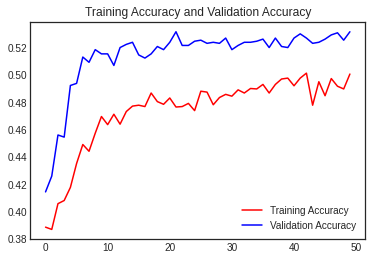

<Figure size 432x288 with 0 Axes>

In [71]:
acc = tl_history.history['accuracy']
val_acc = tl_history.history['val_accuracy']
loss = tl_history.history['loss']
val_loss = tl_history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'r', label='Training Accuracy')
plt.plot(epochs, val_acc, 'b', label='Validation Accuracy')
plt.title('Training Accuracy and Validation Accuracy')
plt.legend(loc=0)
plt.figure()

plt.show()

In [76]:
import numpy as np
from google.colab import files
from tensorflow.keras.preprocessing import image

uploaded = files.upload()

for fn in uploaded.keys():
    path = '/content/' + fn
    img = image.load_img(path, target_size=(150,150))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)

    images = np.vstack([x])
    classes = model.predict(images, batch_size=10)
    print(classes)
    
    for row in classes:
        prediction_list = row.tolist()
        if prediction_list[0] == max(prediction_list):
            print('The image contains a person wearing a balaclava ski mask')
        elif prediction_list[1] == max(prediction_list):
            print('The image contains a person wearing Eye Glasses')
        elif prediction_list[2] == max(prediction_list):
            print('No one in this image is wearing a mask')
        elif prediction_list[3] == max(prediction_list):
            print('I am not sure I know what kind of face covering this image contains')
        elif prediction_list[4] == max(prediction_list):
            print('The image contains a person wearing a face shield')
        elif prediction_list[5] == max(prediction_list):
            print('The image contains a person wearing a face mask')
        elif prediction_list[6] == max(prediction_list):
            print('The image contains a person wearing the mask incorrectly')
        elif prediction_list[7] == max(prediction_list):
            print('The image contains a person wearing gas mask')
        elif prediction_list[8] == max(prediction_list):
            print('The image contains a person wearing goggles')
        elif prediction_list[9] == max(prediction_list):
            print('The image contains a person wearing a hair net')
        elif prediction_list[10] == max(prediction_list):
            print('The image contains a person wearing hat')
        elif prediction_list[11] == max(prediction_list):
            print('The image contains a person wearing a helmet')                                    
        elif prediction_list[12] == max(prediction_list):
            print('The image contains a person wearing hijab niqab')
        elif prediction_list[13] == max(prediction_list):
            print('The image contains a person wearing a hood')
        elif prediction_list[14] == max(prediction_list):
            print('The image contains a person wearing a colorful mask')        
        elif prediction_list[15] == max(prediction_list):
            print('The image contains a person wearing a surgical mask')
        elif prediction_list[16] == max(prediction_list):
            print('The image contains a person wearing some kind of mask')
        elif prediction_list[17] == max(prediction_list):
            print('The image contains a person wearing Scarf Bandana')
        elif prediction_list[18] == max(prediction_list):
            print('The image contains a person sunglasses')                        
        elif prediction_list[19] == max(prediction_list):
            print('The image contains a person wearing a turban')

Saving face mask.jpg to face mask (1).jpg
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 1.6718446e-15 0.0000000e+00
  1.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 6.4802366e-27
  8.9686108e-20 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]]
The image contains a person wearing a face mask
